<div style="float:left">
    <h1 style="width:600px">Objective 2: Regression Models</h1>
</div>
<div style="float:right"><img width="100" src="https://github.com/jreades/i2p/raw/master/img/casa_logo.jpg" /></div>

# 0. Loading Library

In [4]:
import pandas as pd
from sklearn.linear_model import LinearRegression

import numpy as np

import sklearn
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix

import matplotlib.pyplot as plt
import matplotlib
# import seaborn as sn

from time import time

# 1. Travel time result

## 1.1 Merge Datasets

In [7]:
import pandas as pd

Walk = pd.read_csv("Travel_time_Result_final/travel_times_WALK_0822.csv")
Transit = pd.read_csv("Travel_time_Result_final/travel_times_TRANSIT_0822.csv")
Walk_and_Transit = pd.read_csv("Travel_time_Result_final/travel_times_BOTH_0822.csv")
Car = pd.read_csv("Travel_time_Result_final/travel_times_CAR_0822.csv")
Bicycle = pd.read_csv("Travel_time_Result_final/travel_times_BICYCLE_0822.csv")

In [8]:
import pandas as pd

# First, merge Walk and Transit
merged_df = pd.merge(
    Walk[['FID', 'LSOA21CD', 'LSOA21NM', 'BNG_E', 'BNG_N', 'LONG', 'LAT', 'GlobalID', 'geometry', 'id', 'from_id', 'to_id', 'travel_time']],
    Transit[['from_id', 'to_id', 'travel_time']],
    on=['from_id', 'to_id'],
    suffixes=('_Walk', '_Transit')
)

# Then sequentially merge Walk_and_Transit, Car, Bicycle
merged_df = pd.merge(
    merged_df,
    Walk_and_Transit[['from_id', 'to_id', 'travel_time']],
    on=['from_id', 'to_id'],
    how='left'
).rename(columns={'travel_time': 'Walk_and_Transit_travel_time'})

merged_df = pd.merge(
    merged_df,
    Car[['from_id', 'to_id', 'travel_time']],
    on=['from_id', 'to_id'],
    how='left'
).rename(columns={'travel_time': 'Car_travel_time'})

merged_df = pd.merge(
    merged_df,
    Bicycle[['from_id', 'to_id', 'travel_time']],
    on=['from_id', 'to_id'],
    how='left'
).rename(columns={'travel_time': 'Bicycle_travel_time'})

# Rename the columns from the final merge
merged_df = merged_df.rename(columns={'travel_time_Walk': 'Walk_travel_time', 'travel_time_Transit': 'Transit_travel_time'})

In [9]:
merged_df.head(2)

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time
0,1,E01000001,City of London 001A,532123,181632,-0.09714,51.51816,c0565620-19c9-46e4-aea5-7031bb89b7d2,"POLYGON ((532151.5375 181867.433499999, 532152...",1,1,183,10.0,10.0,10.0,4,8
1,2,E01000002,City of London 001B,532480,181715,-0.09197,51.51882,6aac6ffa-0cca-4aec-9a0a-1eeace1ea636,"POLYGON ((532634.497 181926.016000001, 532632....",2,2,183,7.0,7.0,7.0,2,5


## 1.2 Check the difference between "WALK.MODE" and "TRANSIT.MODE"

In [11]:
import pandas as pd

# Assuming merged_df DataFrame already contains all merged data

# Create boolean columns indicating whether the two columns are the same
merged_df['Walk_vs_Transit'] = merged_df['Walk_travel_time'] == merged_df['Transit_travel_time']
merged_df['Walk_vs_Walk_and_Transit'] = merged_df['Walk_travel_time'] == merged_df['Walk_and_Transit_travel_time']
merged_df['Transit_vs_Walk_and_Transit'] = merged_df['Transit_travel_time'] == merged_df['Walk_and_Transit_travel_time']

# Extract rows where the two columns are different, generating new DataFrames
diff_walk_transit = merged_df[~merged_df['Walk_vs_Transit']].copy()
diff_walk_walk_and_transit = merged_df[~merged_df['Walk_vs_Walk_and_Transit']].copy()
diff_transit_walk_and_transit = merged_df[~merged_df['Transit_vs_Walk_and_Transit']].copy()

# Drop the boolean columns since they were only used for comparison
diff_walk_transit.drop(columns=['Walk_vs_Transit', 'Walk_vs_Walk_and_Transit', 'Transit_vs_Walk_and_Transit'], inplace=True)
diff_walk_walk_and_transit.drop(columns=['Walk_vs_Transit', 'Walk_vs_Walk_and_Transit', 'Transit_vs_Walk_and_Transit'], inplace=True)
diff_transit_walk_and_transit.drop(columns=['Walk_vs_Transit', 'Walk_vs_Walk_and_Transit', 'Transit_vs_Walk_and_Transit'], inplace=True)

In [12]:
# Display the number of different rows and the first few rows of the generated DataFrame
print(f"Number of different rows between Walk and Transit modes: {len(diff_walk_transit)}")

diff_walk_transit.head(2)

Number of different rows between Walk and Transit modes: 202


,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time
33,34,E01000038,Barking and Dagenham 003C,550700,187149,0.172761,51.56309,fa864750-afff-44f5-8357-b1a4404f4026,"POLYGON ((550920.362 187341.138, 550921.876 18...",34,34,282,48.0,43.0,43.0,8,19
215,216,E01000228,Barnet 007A,521213,194146,-0.249990,51.63307,728f20bf-3abe-4835-ab44-75e08ac4cf18,"POLYGON ((520025.219 195196.687000001, 520049....",216,216,314,43.0,35.0,35.0,5,18


In [13]:
print(f"Number of different rows between Walk and Walk_and_Transit modes: {len(diff_walk_walk_and_transit)}")

diff_walk_walk_and_transit.head(2)

Number of different rows between Walk and Walk_and_Transit modes: 202


,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time
33,34,E01000038,Barking and Dagenham 003C,550700,187149,0.172761,51.56309,fa864750-afff-44f5-8357-b1a4404f4026,"POLYGON ((550920.362 187341.138, 550921.876 18...",34,34,282,48.0,43.0,43.0,8,19
215,216,E01000228,Barnet 007A,521213,194146,-0.249990,51.63307,728f20bf-3abe-4835-ab44-75e08ac4cf18,"POLYGON ((520025.219 195196.687000001, 520049....",216,216,314,43.0,35.0,35.0,5,18


In [14]:
print(f"Number of different rows between Transit and Walk_and_Transit modes: {len(diff_transit_walk_and_transit)}")

diff_transit_walk_and_transit.head(5)

Number of different rows between Transit and Walk_and_Transit modes: 3


,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time
1363,1364,E01001418,Enfield 011C,528746,196116,-0.140480,51.64910,c9f3d23c-e355-4b59-872e-5b151a751eab,"POLYGON ((528987.426 196489.257999999, 528990....",1364,1364,333,NaN,NaN,NaN,3,9
2636,2637,E01002775,Islington 014D,532336,184986,-0.092810,51.54825,e8d170fa-b982-4d09-b92b-8b2644096c5b,"POLYGON ((532211.796 185057.685000001, 532209....",2637,2637,229,NaN,NaN,NaN,5,10
4847,32517,E01034478,Barking and Dagenham 019I,547576,182291,0.125691,51.52026,1d6afc44-40b3-41ad-8537-ad5139df2a13,"POLYGON ((547525 182987, 547548.97 182981.1300...",32517,32517,169,NaN,NaN,NaN,38,90


In [15]:
merged_df.head(2)

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time,Walk_vs_Transit,Walk_vs_Walk_and_Transit,Transit_vs_Walk_and_Transit
0,1,E01000001,City of London 001A,532123,181632,-0.09714,51.51816,c0565620-19c9-46e4-aea5-7031bb89b7d2,"POLYGON ((532151.5375 181867.433499999, 532152...",1,1,183,10.0,10.0,10.0,4,8,True,True,True
1,2,E01000002,City of London 001B,532480,181715,-0.09197,51.51882,6aac6ffa-0cca-4aec-9a0a-1eeace1ea636,"POLYGON ((532634.497 181926.016000001, 532632....",2,2,183,7.0,7.0,7.0,2,5,True,True,True


In [16]:
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4994 entries, 0 to 4993
Data columns (total 20 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   FID                           4994 non-null   int64  
 1   LSOA21CD                      4994 non-null   object 
 2   LSOA21NM                      4994 non-null   object 
 3   BNG_E                         4994 non-null   int64  
 4   BNG_N                         4994 non-null   int64  
 5   LONG                          4994 non-null   float64
 6   LAT                           4994 non-null   float64
 7   GlobalID                      4994 non-null   object 
 8   geometry                      4994 non-null   object 
 9   id                            4994 non-null   int64  
 10  from_id                       4994 non-null   int64  
 11  to_id                         4994 non-null   int64  
 12  Walk_travel_time              4990 non-null   float64
 13  Tra

# 2. Social-economic factors

## 2.1 Level_4 (Qualifications)

In [19]:
import pandas as pd

Qualifications = pd.read_csv("Dataset/Qualifications, Disability, Health and Care/Qualifications.csv")

In [20]:
Qualifications_percentage = Qualifications.copy()

In [21]:
# Assuming pandas has already been imported
import pandas as pd

# Assuming df is your DataFrame
# Calculate the percentage and replace the original values
columns_to_convert = ['none', 'Level 1', 'Level 2', 'Apprenticeship', 'Level 3', 'Level 4+', 'Other']
Qualifications_percentage[columns_to_convert] = Qualifications_percentage[columns_to_convert].div(Qualifications_percentage['Usual residents aged 16+'], axis=0) * 100


## 2.2 Employment rate

In [23]:
import pandas as pd

Economic_activity_status = pd.read_csv("Dataset/Labour market/Economic activity status_custom-filtered.csv")

In [24]:
# Combine the values of the 'Economic activity status (7 categories) Code' and 'Economic activity status (7 categories)' columns
Economic_activity_status['economic_activity_status'] = (
    Economic_activity_status['Economic activity status (7 categories) Code'].astype(str) + 
    '_' + 
    Economic_activity_status['Economic activity status (7 categories)']
)

In [25]:
# Drop the 'Economic activity status (7 categories) Code' and 'Economic activity status (7 categories)' columns
Economic_activity_status = Economic_activity_status.drop(columns=[
    'Economic activity status (7 categories) Code', 
    'Economic activity status (7 categories)'
])

In [26]:
Economic_activity_status.head(2)

,Lower layer Super Output Areas Code,Lower layer Super Output Areas,Observation,economic_activity_status
0,E01000001,City of London 001A,125,-8_Does not apply
1,E01000001,City of London 001A,856,1_Economically active (excluding full-time stu...


In [27]:
# Use pivot_table to convert the values in the economic_activity_status column into new column names and populate these columns with the Observation values
economic_activity = Economic_activity_status.pivot_table(
    index=['Lower layer Super Output Areas Code', 'Lower layer Super Output Areas'],
    columns='economic_activity_status',
    values='Observation',
    fill_value=0
).reset_index()

In [28]:
economic_activity.head(2)

economic_activity_status,Lower layer Super Output Areas Code,Lower layer Super Output Areas,-8_Does not apply,1_Economically active (excluding full-time students): In employment,2_Economically active (excluding full-time students): Unemployed: Seeking work or waiting to start a job already obtained: Available to start working within 2 weeks,3_Economically active and a full-time student: In employment,4_Economically active and a full-time student: Unemployed: Seeking work or waiting to start a job already obtained: Available to start working within 2 weeks,5_Economically inactive (excluding full-time students),6_Economically inactive and a full-time student
0,E01000001,City of London 001A,125.0,856.0,32.0,10.0,6.0,373.0,76.0
1,E01000002,City of London 001B,86.0,870.0,30.0,8.0,3.0,301.0,85.0


In [29]:
# Change column name to 'Index'
economic_activity.columns.name = 'Index'

In [30]:
# Define the column names to be summed
columns_to_sum = [
    '-8_Does not apply',
    '1_Economically active (excluding full-time students): In employment',
    '2_Economically active (excluding full-time students): Unemployed: Seeking work or waiting to start a job already obtained: Available to start working within 2 weeks',
    '3_Economically active and a full-time student: In employment',
    '4_Economically active and a full-time student: Unemployed: Seeking work or waiting to start a job already obtained: Available to start working within 2 weeks',
    '5_Economically inactive (excluding full-time students)',
    '6_Economically inactive and a full-time student'
]

# Create a new column 'total_population', which is the sum of the above seven columns
economic_activity['total_population'] = economic_activity[columns_to_sum].sum(axis=1)

In [31]:
economic_activity.head(2)

Index,Lower layer Super Output Areas Code,Lower layer Super Output Areas,-8_Does not apply,1_Economically active (excluding full-time students): In employment,2_Economically active (excluding full-time students): Unemployed: Seeking work or waiting to start a job already obtained: Available to start working within 2 weeks,3_Economically active and a full-time student: In employment,4_Economically active and a full-time student: Unemployed: Seeking work or waiting to start a job already obtained: Available to start working within 2 weeks,5_Economically inactive (excluding full-time students),6_Economically inactive and a full-time student,total_population
0,E01000001,City of London 001A,125.0,856.0,32.0,10.0,6.0,373.0,76.0,1478.0
1,E01000002,City of London 001B,86.0,870.0,30.0,8.0,3.0,301.0,85.0,1383.0


In [32]:
employment_rate_columns = [
    'Lower layer Super Output Areas Code',
    'Lower layer Super Output Areas',
    '1_Economically active (excluding full-time students): In employment',
    'total_population' 
]

In [33]:
employment_rate = economic_activity[employment_rate_columns] 

In [34]:
employment_rate_copy = employment_rate.copy()

In [35]:
employment_rate_copy['employment_rate'] = employment_rate['1_Economically active (excluding full-time students): In employment'].div(employment_rate['total_population'], axis=0) * 100

In [36]:
employment_rate_copy.head(2)

Index,Lower layer Super Output Areas Code,Lower layer Super Output Areas,1_Economically active (excluding full-time students): In employment,total_population,employment_rate
0,E01000001,City of London 001A,856.0,1478.0,57.916103
1,E01000002,City of London 001B,870.0,1383.0,62.906725


# 3. Merge Datasets

In [38]:
merged_df.head(2)

,FID,LSOA21CD,LSOA21NM,BNG_E,BNG_N,LONG,LAT,GlobalID,geometry,id,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time,Walk_vs_Transit,Walk_vs_Walk_and_Transit,Transit_vs_Walk_and_Transit
0,1,E01000001,City of London 001A,532123,181632,-0.09714,51.51816,c0565620-19c9-46e4-aea5-7031bb89b7d2,"POLYGON ((532151.5375 181867.433499999, 532152...",1,1,183,10.0,10.0,10.0,4,8,True,True,True
1,2,E01000002,City of London 001B,532480,181715,-0.09197,51.51882,6aac6ffa-0cca-4aec-9a0a-1eeace1ea636,"POLYGON ((532634.497 181926.016000001, 532632....",2,2,183,7.0,7.0,7.0,2,5,True,True,True


In [39]:
columns_refine = ['FID','LSOA21CD','LSOA21NM','geometry',
                  'from_id','to_id',
                  'Walk_travel_time','Transit_travel_time','Walk_and_Transit_travel_time','Car_travel_time','Bicycle_travel_time']

In [40]:
merged_df_refine = merged_df[columns_refine]

In [41]:
merged_df_refine.head(2)

,FID,LSOA21CD,LSOA21NM,geometry,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time
0,1,E01000001,City of London 001A,"POLYGON ((532151.5375 181867.433499999, 532152...",1,183,10.0,10.0,10.0,4,8
1,2,E01000002,City of London 001B,"POLYGON ((532634.497 181926.016000001, 532632....",2,183,7.0,7.0,7.0,2,5


In [42]:
Qualifications_percentage.head(2)

,LSOA code,local authority code,local authority name,Usual residents aged 16+,none,Level 1,Level 2,Apprenticeship,Level 3,Level 4+,Other
0,E01000001,E09000001,City of London,1353,2.365115,1.921656,3.991131,0.960828,6.356245,83.222469,1.182557
1,E01000002,E09000001,City of London,1300,1.769231,2.153846,4.000000,0.307692,6.846154,83.538462,1.384615


In [43]:
employment_rate_copy.head(2)

Index,Lower layer Super Output Areas Code,Lower layer Super Output Areas,1_Economically active (excluding full-time students): In employment,total_population,employment_rate
0,E01000001,City of London 001A,856.0,1478.0,57.916103
1,E01000002,City of London 001B,870.0,1383.0,62.906725


In [44]:
# Use the merge function of pandas to merge two DataFrames.
Final_df = merged_df_refine.merge(
    Qualifications_percentage[['LSOA code', 'Level 3', 'Level 4+']],
    left_on='LSOA21CD',
    right_on='LSOA code',
    how='left'
)

In [45]:
# Remove duplicate LSOA code columns
Final_df = Final_df.drop(columns=['LSOA code'])

In [46]:
Final_df.head(2)

,FID,LSOA21CD,LSOA21NM,geometry,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time,Level 3,Level 4+
0,1,E01000001,City of London 001A,"POLYGON ((532151.5375 181867.433499999, 532152...",1,183,10.0,10.0,10.0,4,8,6.356245,83.222469
1,2,E01000002,City of London 001B,"POLYGON ((532634.497 181926.016000001, 532632....",2,183,7.0,7.0,7.0,2,5,6.846154,83.538462


In [47]:
# Use the merge function of pandas to merge two DataFrames.
Final_df = Final_df.merge(
    employment_rate_copy[['Lower layer Super Output Areas Code', 'employment_rate']],
    left_on='LSOA21CD',
    right_on='Lower layer Super Output Areas Code',
    how='left'
)

In [48]:
# Delete the `Lower layer Super Output Areas Code' column
Final_df = Final_df.drop(columns=['Lower layer Super Output Areas Code'])

In [49]:
Final_df = Final_df.rename(columns = {'Level 3':'Level_3','Level 4+':'Level_4',})

In [50]:
Final_df.head(2)

,FID,LSOA21CD,LSOA21NM,geometry,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time,Level_3,Level_4,employment_rate
0,1,E01000001,City of London 001A,"POLYGON ((532151.5375 181867.433499999, 532152...",1,183,10.0,10.0,10.0,4,8,6.356245,83.222469,57.916103
1,2,E01000002,City of London 001B,"POLYGON ((532634.497 181926.016000001, 532632....",2,183,7.0,7.0,7.0,2,5,6.846154,83.538462,62.906725


In [51]:
# Filter all rows containing NA values and save to Final_df_NA

Final_df_NA = Final_df[Final_df.isna().any(axis=1)]
Final_df_NA.head()

,FID,LSOA21CD,LSOA21NM,geometry,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time,Level_3,Level_4,employment_rate
1363,1364,E01001418,Enfield 011C,"POLYGON ((528987.426 196489.257999999, 528990....",1364,333,NaN,NaN,NaN,3,9,14.574616,41.352859,42.701149
2330,2331,E01002444,Hillingdon 031A,"POLYGON ((505791.209 178363.541999999, 505784....",2331,77,NaN,89.0,89.0,25,51,10.301508,30.213568,46.726505
2636,2637,E01002775,Islington 014D,"POLYGON ((532211.796 185057.685000001, 532209....",2637,229,NaN,NaN,NaN,5,10,10.858995,68.800648,62.855114
4847,32517,E01034478,Barking and Dagenham 019I,"POLYGON ((547525 182987, 547548.97 182981.1300...",32517,169,NaN,NaN,NaN,38,90,13.317757,59.813084,57.429048


# 4. Analysis

In [53]:
df_analysis_columns = ['Walk_and_Transit_travel_time','Car_travel_time','Bicycle_travel_time', 'Level_4','employment_rate']

In [54]:
df_analysis = Final_df[df_analysis_columns]

In [55]:
df_analysis = df_analysis.dropna()

In [56]:
df_analysis.shape

(4991, 5)

In [57]:
df_analysis.corr()

,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time,Level_4,employment_rate
Walk_and_Transit_travel_time,1.000000,0.710459,0.841661,-0.158248,-0.086106
Car_travel_time,0.710459,1.000000,0.636005,-0.026568,-0.001127
Bicycle_travel_time,0.841661,0.636005,1.000000,-0.080071,-0.045383
Level_4,-0.158248,-0.026568,-0.080071,1.000000,0.728634
employment_rate,-0.086106,-0.001127,-0.045383,0.728634,1.000000


In [58]:
df_analysis.corr(method='pearson')

,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time,Level_4,employment_rate
Walk_and_Transit_travel_time,1.000000,0.710459,0.841661,-0.158248,-0.086106
Car_travel_time,0.710459,1.000000,0.636005,-0.026568,-0.001127
Bicycle_travel_time,0.841661,0.636005,1.000000,-0.080071,-0.045383
Level_4,-0.158248,-0.026568,-0.080071,1.000000,0.728634
employment_rate,-0.086106,-0.001127,-0.045383,0.728634,1.000000


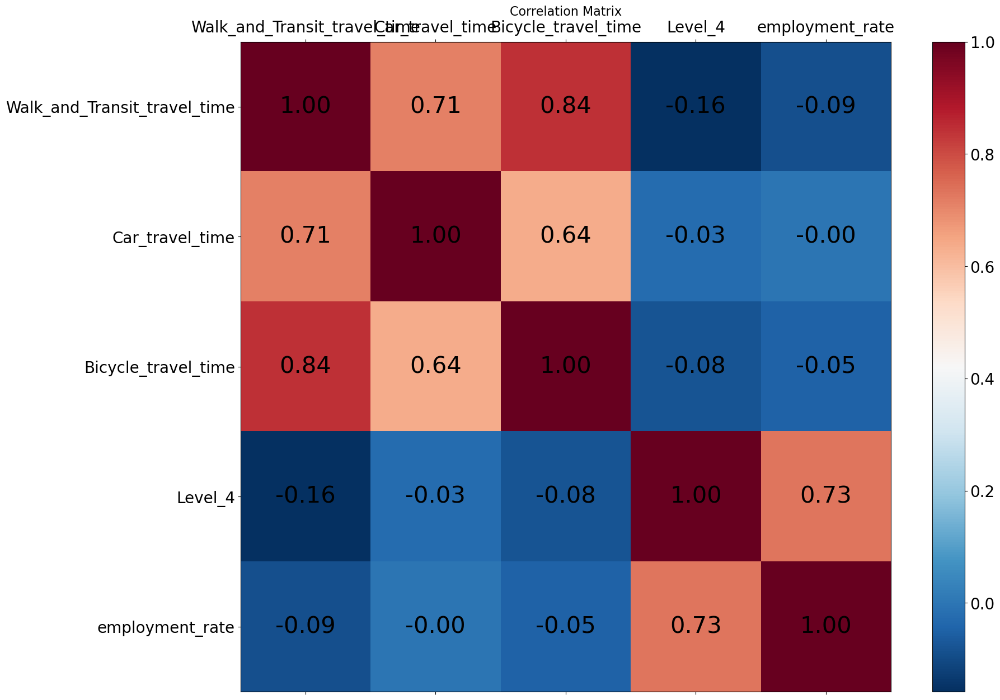

In [59]:
import numpy as np
import matplotlib.pyplot as plt

df = df_analysis
plt.rcParams["axes.grid"] = False
f = plt.figure(figsize=(19, 15))

# Plot the correlation matrix with a 'coolwarm' color map
corr_matrix = df.corr()
plt.matshow(corr_matrix, fignum=f.number, cmap='RdBu_r')

# Add a color bar using the same color map as the heatmap
cb = plt.colorbar()
cb.ax.tick_params(labelsize=20)

# Add tick labels
plt.xticks(range(df.shape[1]), df.columns, fontsize=20, rotation=0)
plt.yticks(range(df.shape[1]), df.columns, fontsize=20)

# Add the correlation coefficient values to each cell
for (i, j), val in np.ndenumerate(corr_matrix.values):
    plt.text(j, i, f'{val:.2f}', ha='center', va='center', fontsize=30, color='black')

# Add a title
plt.title('Correlation Matrix', fontsize=16)

# # Save the image as a PNG file
# plt.savefig('Plot/correlation_matrix_improved.png', format='png', dpi=300, bbox_inches='tight')

# Display the chart
plt.show()

# 5. Regression

In [61]:
import pandas as pd
from sklearn.linear_model import LinearRegression
import statsmodels
import statsmodels.api as sm

import numpy as np

import sklearn
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix

import matplotlib.pyplot as plt
import seaborn as sn

In [62]:
df_analysis.head(2)

,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time,Level_4,employment_rate
0,10.0,4,8,83.222469,57.916103
1,7.0,2,5,83.538462,62.906725


## 5.1 Level 4

### 5.1.1 Level 4——Walk and Transit

In [65]:
model_Level_4_WT = sm.formula.ols('Level_4 ~ Walk_and_Transit_travel_time', df_analysis).fit()
model_Level_4_WT.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                Level_4   R-squared:                       0.025
Model:                            OLS   Adj. R-squared:                  0.025
Method:                 Least Squares   F-statistic:                     128.1
Date:                Thu, 29 Aug 2024   Prob (F-statistic):           2.37e-29
Time:                        15:24:14   Log-Likelihood:                -20134.
No. Observations:                4991   AIC:                         4.027e+04
Df Residuals:                    4989   BIC:                         4.029e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
Intercept                       50.8805      0.410    123.968      0.000      50.076      51.685
Walk_and_Transit_travel_time    -0.2241      0.020    -11.320      0.000      -0.263      -0.185
==============================================================================
Omnibus:                      438.574   Durbin-Watson:                   0.654
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              243.764
Skew:                           0.395   Prob(JB):                     1.17e-53
Kurtosis:                       2.259   Cond. No.                         44.0
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

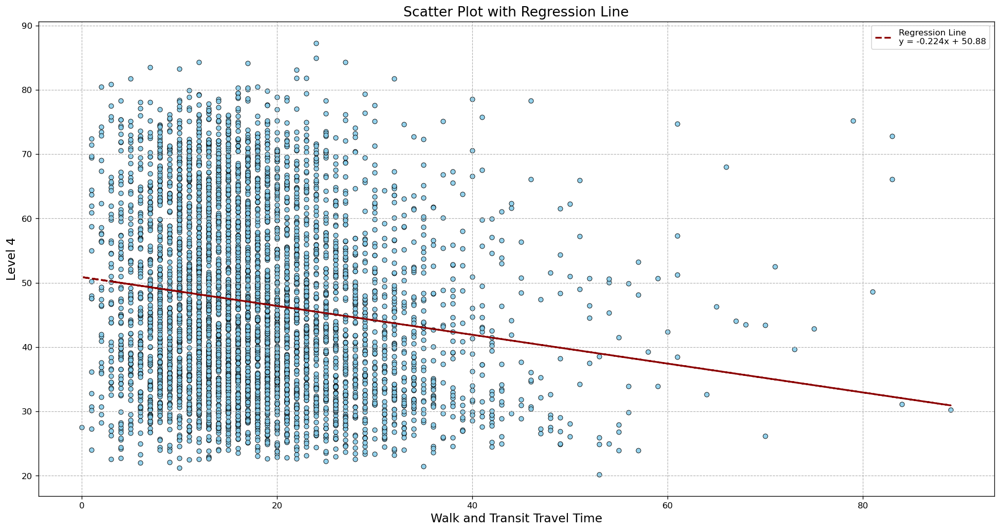

y = -0.224 x + 50.88
Rsq =  0.025042358412342258
p-value of Walk_and_Transit_travel_time =  0.0


In [66]:
import matplotlib.pyplot as plt

# Get the regression model parameters and statistics
beta_0, beta_1 = model_Level_4_WT.params
rsq = model_Level_4_WT.rsquared
pval_0, pval_1 = model_Level_4_WT.pvalues

# Create a plot object
fig, ax = plt.subplots(figsize=(20, 10), dpi=120)

# Plot the scatter plot with custom colors
df_analysis.plot(kind='scatter', x='Walk_and_Transit_travel_time', y='Level_4', ax=ax, color='skyblue', s=30, edgecolor='black', linewidths=0.6, alpha=0.9)

# Plot the regression line
X = df_analysis.Walk_and_Transit_travel_time
ax.plot(X, X * beta_1 + beta_0, color='darkred', linewidth=2, linestyle='--', label=f'Regression Line\ny = {round(beta_1, 3)}x + {round(beta_0, 3)}')

# Set the title and axis labels
ax.set_title('Scatter Plot with Regression Line', fontsize=16)
ax.set_xlabel('Walk and Transit Travel Time', fontsize=14)
ax.set_ylabel('Level 4', fontsize=14)

# # Set the x and y axis limits
# ax.set_xlim(0, 100)
# ax.set_ylim(0, 100)

# Add grid lines
ax.grid(True, which='both', linestyle='--', linewidth=0.7)

# Show the legend
ax.legend()

plt.savefig('Plot_final_0826/Walk_and_Transit_Level_4.png', format='png', dpi=120)

# Display the chart
plt.show()

# Print the regression equation and other statistics
print("y =", round(beta_1, 3), "x +", round(beta_0, 3))
print("Rsq = ", rsq)
print("p-value of Walk_and_Transit_travel_time = ", round(pval_1, 5))


### 5.1.2 Level 4 —— Car

In [68]:
model_Level_4_C = sm.formula.ols('Level_4 ~ Car_travel_time', df_analysis).fit()
model_Level_4_C.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                Level_4   R-squared:                       0.001
Model:                            OLS   Adj. R-squared:                  0.001
Method:                 Least Squares   F-statistic:                     3.524
Date:                Thu, 29 Aug 2024   Prob (F-statistic):             0.0605
Time:                        15:24:15   Log-Likelihood:                -20196.
No. Observations:                4991   AIC:                         4.040e+04
Df Residuals:                    4989   BIC:                         4.041e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
Intercept          47.4186      0.391    121.240      0.000      46.652      48.185
Car_travel_time    -0.1495      0.080     -1.877      0.061      -0.306       0.007
==============================================================================
Omnibus:                      524.152   Durbin-Watson:                   0.614
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              263.625
Skew:                           0.402   Prob(JB):                     5.68e-58
Kurtosis:                       2.211   Cond. No.                         10.1
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

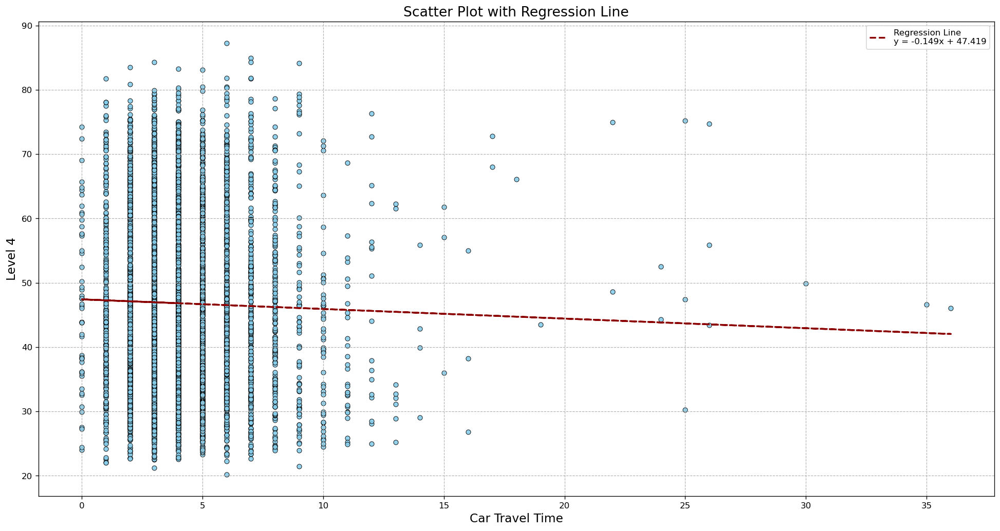

y = -0.149 x + 47.419
Rsq =  0.0007058326599891362
p-value of Car_travel_time =  0.06055


In [69]:
import matplotlib.pyplot as plt

# Get the regression model parameters and statistics
beta_0, beta_1 = model_Level_4_C.params
rsq    = model_Level_4_C.rsquared
pval_0, pval_1 = model_Level_4_C.pvalues

# Create a plot object
fig, ax = plt.subplots(figsize=(20, 10), dpi=120)

# Plot the scatter plot with custom colors
df_analysis.plot(kind='scatter', x='Car_travel_time', y='Level_4', ax=ax, color='skyblue', s=30, edgecolor='black', linewidths=0.6, alpha=0.9)

# Plot the regression line
X = df_analysis.Car_travel_time
ax.plot(X, X * beta_1 + beta_0, color='darkred', linewidth=2, linestyle='--', label=f'Regression Line\ny = {round(beta_1, 3)}x + {round(beta_0, 3)}')

# Set the title and axis labels
ax.set_title('Scatter Plot with Regression Line', fontsize=16)
ax.set_xlabel('Car Travel Time', fontsize=14)
ax.set_ylabel('Level 4', fontsize=14)

# # Set the x and y axis limits
# ax.set_xlim(0, 100)
# ax.set_ylim(0, 100)

# Add grid lines
ax.grid(True, which='both', linestyle='--', linewidth=0.7)

# Show the legend
ax.legend()

plt.savefig('Plot_final_0826/Car_Level_4.png', format='png', dpi=120)

# Display the chart
plt.show()

# Print the regression equation and other statistics
print("y =", round(beta_1, 3), "x +", round(beta_0, 3))
print("Rsq = ", rsq)
print("p-value of Car_travel_time = ", round(pval_1, 5))


### 5.1.3 Level 4 —— Bicycle

In [71]:
model_Level_4_B = sm.formula.ols('Level_4 ~ Bicycle_travel_time', df_analysis).fit()
model_Level_4_B.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                Level_4   R-squared:                       0.006
Model:                            OLS   Adj. R-squared:                  0.006
Method:                 Least Squares   F-statistic:                     32.19
Date:                Thu, 29 Aug 2024   Prob (F-statistic):           1.47e-08
Time:                        15:24:15   Log-Likelihood:                -20181.
No. Observations:                4991   AIC:                         4.037e+04
Df Residuals:                    4989   BIC:                         4.038e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept              48.6565      0.384    126.830      0.000      47.904      49.409
Bicycle_travel_time    -0.2178      0.038     -5.674      0.000      -0.293      -0.143
==============================================================================
Omnibus:                      518.726   Durbin-Watson:                   0.624
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              256.602
Skew:                           0.391   Prob(JB):                     1.90e-56
Kurtosis:                       2.211   Cond. No.                         19.8
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

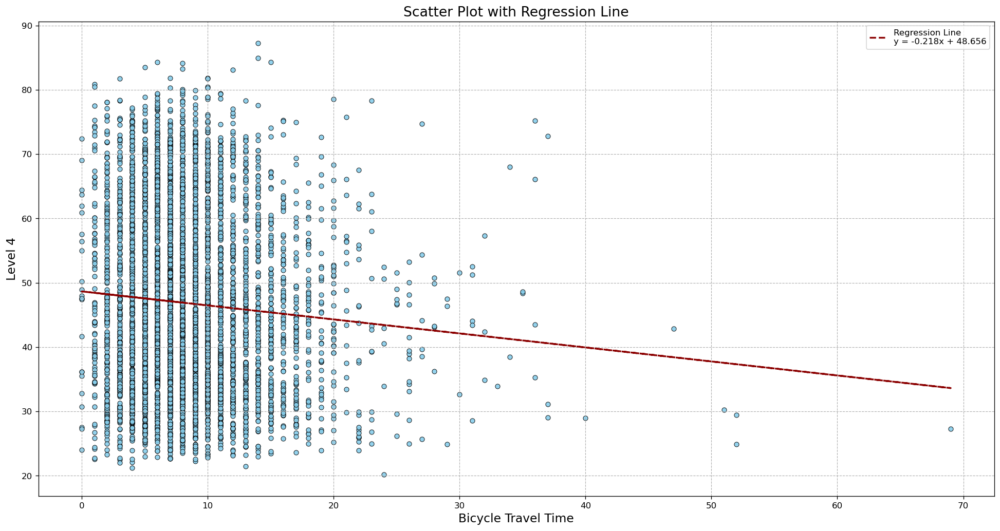

y = -0.218 x + 48.656
Rsq =  0.006411400130010292
p-value of Bicycle_travel_time =  0.0


In [72]:
import matplotlib.pyplot as plt

# Get the regression model parameters and statistics
beta_0, beta_1 = model_Level_4_B.params
rsq    = model_Level_4_B.rsquared
pval_0, pval_1 = model_Level_4_B.pvalues

# Create a plot object
fig, ax = plt.subplots(figsize=(20, 10), dpi=120)

# Plot the scatter plot with custom colors
df_analysis.plot(kind='scatter', x='Bicycle_travel_time', y='Level_4', ax=ax, color='skyblue', s=30, edgecolor='black', linewidths=0.6, alpha=0.9)

# Plot the regression line
X = df_analysis.Bicycle_travel_time
ax.plot(X, X * beta_1 + beta_0, color='darkred', linewidth=2, linestyle='--', label=f'Regression Line\ny = {round(beta_1, 3)}x + {round(beta_0, 3)}')

# Set the title and axis labels
ax.set_title('Scatter Plot with Regression Line', fontsize=16)
ax.set_xlabel('Bicycle Travel Time', fontsize=14)
ax.set_ylabel('Level 4', fontsize=14)

# # Set the x and y axis limits
# ax.set_xlim(0, 100)
# ax.set_ylim(0, 100)

# Add grid lines
ax.grid(True, which='both', linestyle='--', linewidth=0.7)

# Show the legend
ax.legend()

plt.savefig('Plot_final_0826/Bicycle_Level_4.png', format='png', dpi=120)

# Display the chart
plt.show()

# Print the regression equation and other statistics
print("y =", round(beta_1, 3), "x +", round(beta_0, 3))
print("Rsq = ", rsq)
print("p-value of Bicycle_travel_time = ", round(pval_1, 5))


### 5.1.4 Plot the regression model results of Level_4

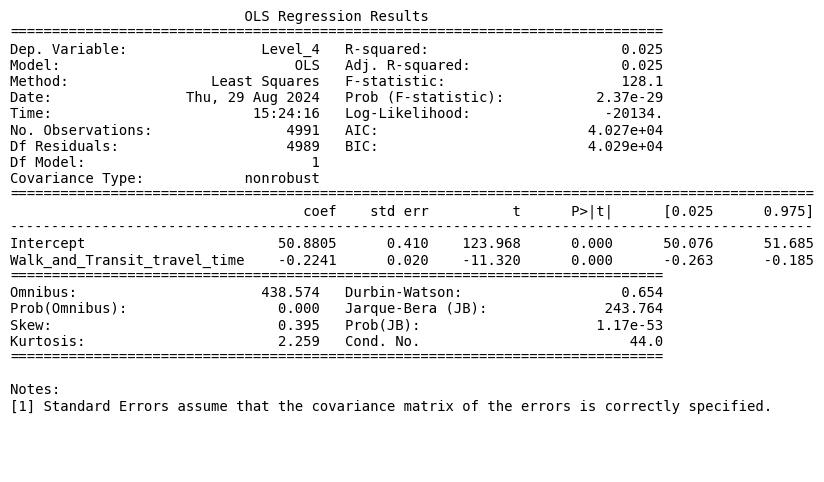

In [74]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from io import BytesIO

# Convert the regression results to a string
result_summary_WT = model_Level_4_WT.summary().as_text()

# Create a Matplotlib figure
fig, ax = plt.subplots(figsize=(10, 6))  # You can adjust the size

# Hide the axes
ax.axis('off')

# Display the regression results text in the figure
ax.text(0, 1, result_summary_WT, fontsize=10, ha='left', va='top', family='monospace')

# Save as a PNG file
plt.savefig('Plot/OLS_regression_results_Level_4_WT.png', bbox_inches='tight', dpi=300)

# Display the image
plt.show()


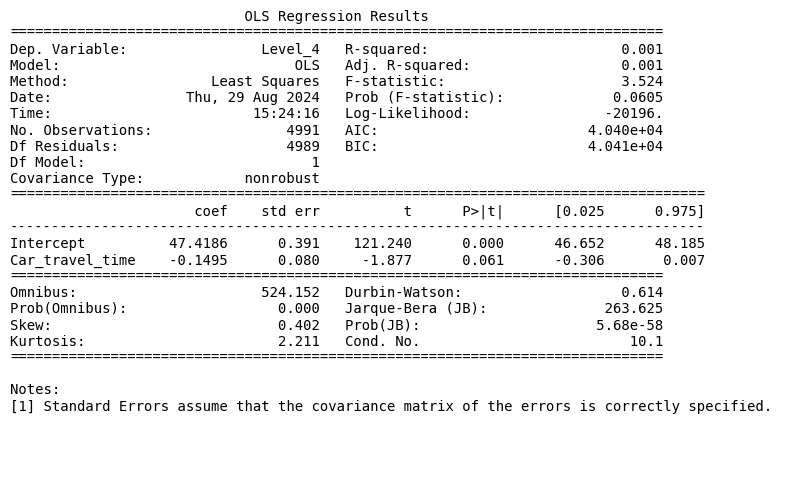

In [75]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from io import BytesIO

# Convert the regression results to a string
result_summary_C = model_Level_4_C.summary().as_text()

# Create a Matplotlib figure
fig, ax = plt.subplots(figsize=(10, 6))  # You can adjust the size

# Hide the axes
ax.axis('off')

# Display the regression results text in the figure
ax.text(0, 1, result_summary_C, fontsize=10, ha='left', va='top', family='monospace')

# Save as a PNG file
plt.savefig('Plot/OLS_regression_results_Level_4_C.png', bbox_inches='tight', dpi=300)

# Display the image
plt.show()


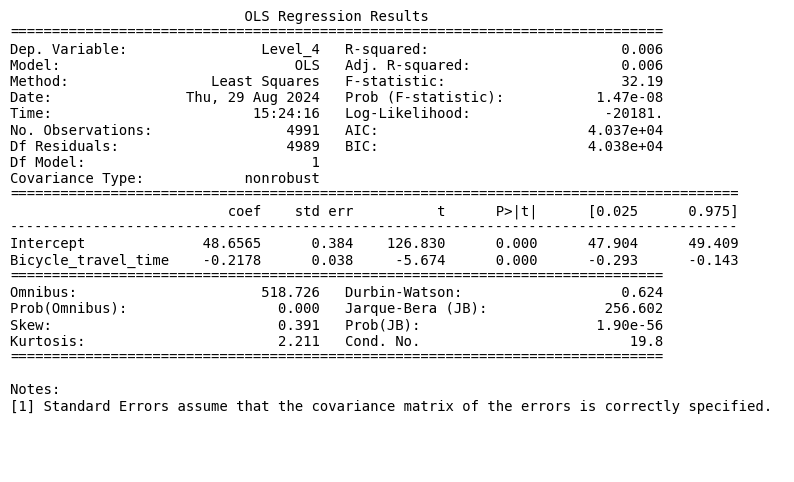

In [76]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from io import BytesIO

# Convert the regression results to a string
result_summary_B = model_Level_4_B.summary().as_text()

# Create a Matplotlib figure
fig, ax = plt.subplots(figsize=(10, 6))  # You can adjust the size

# Hide the axes
ax.axis('off')

# Display the regression results text in the figure
ax.text(0, 1, result_summary_B, fontsize=10, ha='left', va='top', family='monospace')

# Save as a PNG file
plt.savefig('Plot/OLS_regression_results_Level_4_B.png', bbox_inches='tight', dpi=300)

# Display the image
plt.show()


## 5.2 Employment rate

### 5.2.1 Employment rate —— Walk and Transit

In [79]:
model_employment_rate_WT = sm.formula.ols('employment_rate ~ Walk_and_Transit_travel_time', df_analysis).fit()
model_employment_rate_WT.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        employment_rate   R-squared:                       0.007
Model:                            OLS   Adj. R-squared:                  0.007
Method:                 Least Squares   F-statistic:                     37.27
Date:                Thu, 29 Aug 2024   Prob (F-statistic):           1.11e-09
Time:                        15:24:17   Log-Likelihood:                -17074.
No. Observations:                4991   AIC:                         3.415e+04
Df Residuals:                    4989   BIC:                         3.417e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
================================================================================================
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
Intercept                       49.3762      0.222    222.089      0.000      48.940      49.812
Walk_and_Transit_travel_time    -0.0655      0.011     -6.105      0.000      -0.086      -0.044
==============================================================================
Omnibus:                      404.129   Durbin-Watson:                   1.066
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              661.123
Skew:                           0.608   Prob(JB):                    2.75e-144
Kurtosis:                       4.304   Cond. No.                         44.0
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

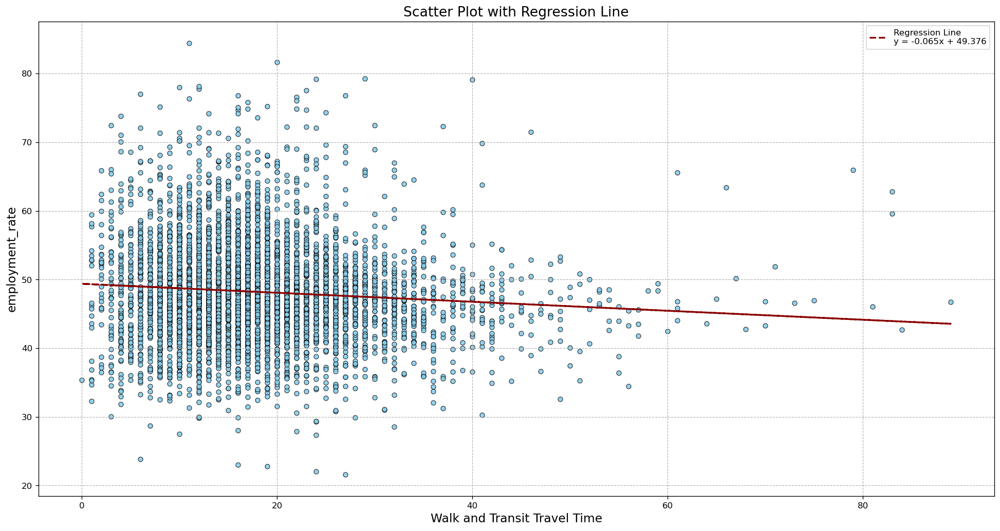

y = -0.065 x + 49.376
Rsq =  0.007414179183796832
p-value of Walk_and_Transit_travel_time =  0.0


In [80]:
import matplotlib.pyplot as plt

# Get the regression model parameters and statistics
beta_0, beta_1 = model_employment_rate_WT.params
rsq    = model_employment_rate_WT.rsquared
pval_0, pval_1 = model_employment_rate_WT.pvalues

# Create a plot object
fig, ax = plt.subplots(figsize=(20, 10), dpi=120)

# Plot the scatter plot with custom colors
df_analysis.plot(kind='scatter', x='Walk_and_Transit_travel_time', y='employment_rate', ax=ax, color='skyblue', s=30, edgecolor='black', linewidths=0.6, alpha=0.9)

# Plot the regression line
X = df_analysis.Walk_and_Transit_travel_time
ax.plot(X, X * beta_1 + beta_0, color='darkred', linewidth=2, linestyle='--', label=f'Regression Line\ny = {round(beta_1, 3)}x + {round(beta_0, 3)}')

# Set the title and axis labels
ax.set_title('Scatter Plot with Regression Line', fontsize=16)
ax.set_xlabel('Walk and Transit Travel Time', fontsize=14)
ax.set_ylabel('employment_rate', fontsize=14)

# # Set the x and y axis limits
# ax.set_xlim(0, 100)
# ax.set_ylim(0, 100)

# Add grid lines
ax.grid(True, which='both', linestyle='--', linewidth=0.7)

# Show the legend
ax.legend()

# Save the plot as a PNG file
plt.savefig('Plot_final_0826/Walk_and_Transit_employment_rate.png', format='png', dpi=120)

# Display the chart
plt.show()

# Print the regression equation and other statistics
print("y =", round(beta_1, 3), "x +", round(beta_0, 3))
print("Rsq = ", rsq)
print("p-value of Walk_and_Transit_travel_time = ", round(pval_1, 5))


### 5.2.2 Employment rate —— Car

In [82]:
model_employment_rate_C = sm.formula.ols('employment_rate ~ Car_travel_time', df_analysis).fit()
model_employment_rate_C.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        employment_rate   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                  0.006336
Date:                Thu, 29 Aug 2024   Prob (F-statistic):              0.937
Time:                        15:24:17   Log-Likelihood:                -17093.
No. Observations:                4991   AIC:                         3.419e+04
Df Residuals:                    4989   BIC:                         3.420e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
Intercept          48.1938      0.210    229.445      0.000      47.782      48.606
Car_travel_time    -0.0034      0.043     -0.080      0.937      -0.087       0.080
==============================================================================
Omnibus:                      415.192   Durbin-Watson:                   1.055
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              661.795
Skew:                           0.630   Prob(JB):                    1.96e-144
Kurtosis:                       4.262   Cond. No.                         10.1
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

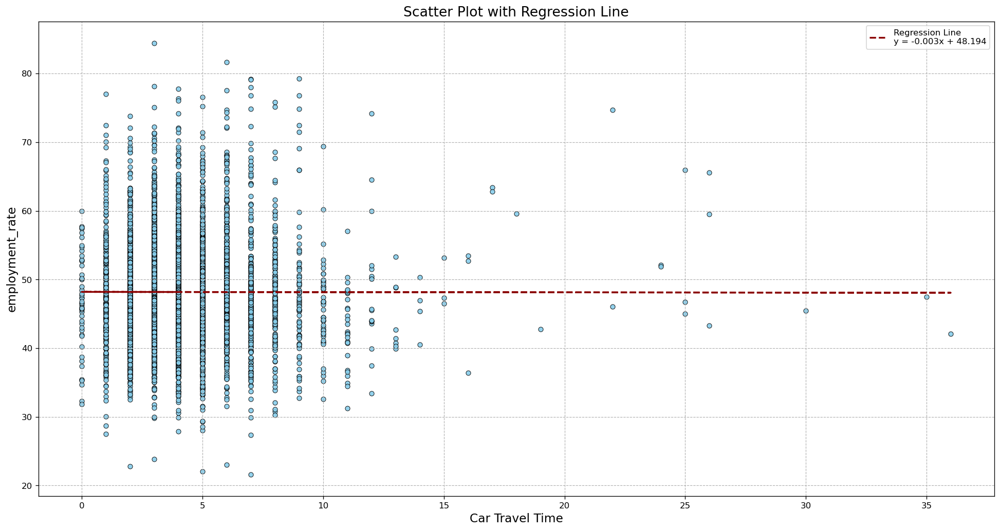

y = -0.003 x + 48.194
Rsq =  1.2699315776742992e-06
p-value of Car_travel_time =  0.93656


In [83]:
import matplotlib.pyplot as plt

# Get the regression model parameters and statistics
beta_0, beta_1 = model_employment_rate_C.params
rsq    = model_employment_rate_C.rsquared
pval_0, pval_1 = model_employment_rate_C.pvalues

# Create a plot object
fig, ax = plt.subplots(figsize=(20, 10), dpi=120)

# Plot the scatter plot with custom colors
df_analysis.plot(kind='scatter', x='Car_travel_time', y='employment_rate', ax=ax, color='skyblue', s=30, edgecolor='black', linewidths=0.6, alpha=0.9)

# Plot the regression line
X = df_analysis.Car_travel_time
ax.plot(X, X * beta_1 + beta_0, color='darkred', linewidth=2, linestyle='--', label=f'Regression Line\ny = {round(beta_1, 3)}x + {round(beta_0, 3)}')

# Set the title and axis labels
ax.set_title('Scatter Plot with Regression Line', fontsize=16)
ax.set_xlabel('Car Travel Time', fontsize=14)
ax.set_ylabel('employment_rate', fontsize=14)

# # Set the x and y axis limits
# ax.set_xlim(0, 100)
# ax.set_ylim(0, 100)

# Add grid lines
ax.grid(True, which='both', linestyle='--', linewidth=0.7)

# Show the legend
ax.legend()

# Save the plot as a PNG file
plt.savefig('Plot_final_0826/Car_employment_rate.png', format='png', dpi=120)

# Display the chart
plt.show()

# Print the regression equation and other statistics
print("y =", round(beta_1, 3), "x +", round(beta_0, 3))
print("Rsq = ", rsq)
print("p-value of Car_travel_time = ", round(pval_1, 5))


### 5.2.3 Employment rate —— Bicycle

In [85]:
model_employment_rate_B = sm.formula.ols('employment_rate ~ Bicycle_travel_time', df_analysis).fit()
model_employment_rate_B.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        employment_rate   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     10.30
Date:                Thu, 29 Aug 2024   Prob (F-statistic):            0.00134
Time:                        15:24:17   Log-Likelihood:                -17088.
No. Observations:                4991   AIC:                         3.418e+04
Df Residuals:                    4989   BIC:                         3.419e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Intercept              48.7494      0.206    236.181      0.000      48.345      49.154
Bicycle_travel_time    -0.0663      0.021     -3.209      0.001      -0.107      -0.026
==============================================================================
Omnibus:                      409.631   Durbin-Watson:                   1.059
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              660.497
Skew:                           0.620   Prob(JB):                    3.76e-144
Kurtosis:                       4.281   Cond. No.                         19.8
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

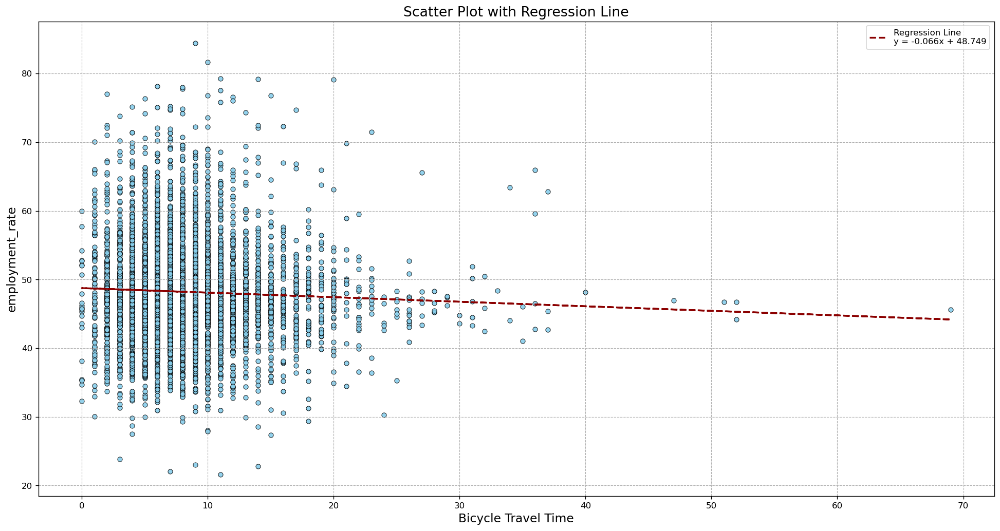

y = -0.066 x + 48.749
Rsq =  0.0020596610844363372
p-value of Bicycle_travel_time =  0.00134


In [86]:
import matplotlib.pyplot as plt

# Get the regression model parameters and statistics
beta_0, beta_1 = model_employment_rate_B.params
rsq    = model_employment_rate_B.rsquared
pval_0, pval_1 = model_employment_rate_B.pvalues

# Create a plot object
fig, ax = plt.subplots(figsize=(20, 10), dpi=120)

# Plot the scatter plot with custom colors
df_analysis.plot(kind='scatter', x='Bicycle_travel_time', y='employment_rate', ax=ax, color='skyblue', s=30, edgecolor='black', linewidths=0.6, alpha=0.9)

# Plot the regression line
X = df_analysis.Bicycle_travel_time
ax.plot(X, X * beta_1 + beta_0, color='darkred', linewidth=2, linestyle='--', label=f'Regression Line\ny = {round(beta_1, 3)}x + {round(beta_0, 3)}')

# Set the title and axis labels
ax.set_title('Scatter Plot with Regression Line', fontsize=16)
ax.set_xlabel('Bicycle Travel Time', fontsize=14)
ax.set_ylabel('employment_rate', fontsize=14)

# # Set the x and y axis limits
# ax.set_xlim(0, 100)
# ax.set_ylim(0, 100)

# Add grid lines
ax.grid(True, which='both', linestyle='--', linewidth=0.7)

# Show the legend
ax.legend()

# Save the plot as a PNG file
plt.savefig('Plot_final_0826/Bicycle_employment_rate.png', format='png', dpi=120)

# Display the chart
plt.show()

# Print the regression equation and other statistics
print("y =", round(beta_1, 3), "x +", round(beta_0, 3))
print("Rsq = ", rsq)
print("p-value of Bicycle_travel_time = ", round(pval_1, 5))


### 5.2.4 Plot the regression model results of Employment Rate

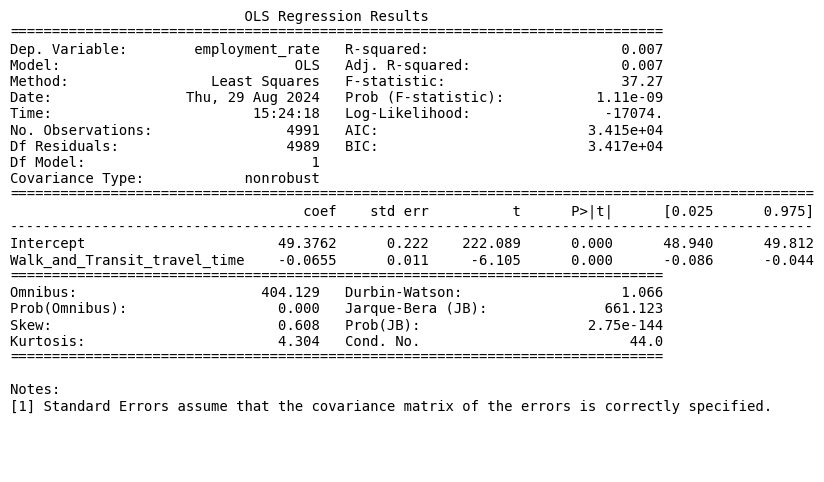

In [88]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from io import BytesIO

# Convert the regression results to a string
result_summary_WT = model_employment_rate_WT.summary().as_text()

# Create a Matplotlib figure
fig, ax = plt.subplots(figsize=(10, 6))  # You can adjust the size

# Hide the axes
ax.axis('off')

# Display the regression results text in the figure
ax.text(0, 1, result_summary_WT, fontsize=10, ha='left', va='top', family='monospace')

# Save as a PNG file
plt.savefig('Plot/OLS_regression_employment_rate_WT.png', bbox_inches='tight', dpi=300)

# Display the image
plt.show()


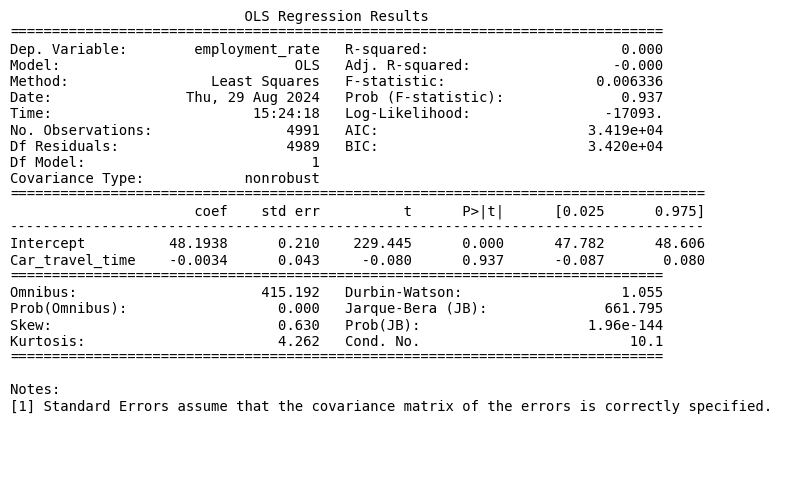

In [89]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from io import BytesIO

# Convert the regression results to a string
result_summary_C = model_employment_rate_C.summary().as_text()

# Create a Matplotlib figure
fig, ax = plt.subplots(figsize=(10, 6))  # You can adjust the size

# Hide the axes
ax.axis('off')

# Display the regression results text in the figure
ax.text(0, 1, result_summary_C, fontsize=10, ha='left', va='top', family='monospace')

# Save as a PNG file
plt.savefig('Plot/OLS_regression_employment_rate_C.png', bbox_inches='tight', dpi=300)

# Display the image
plt.show()


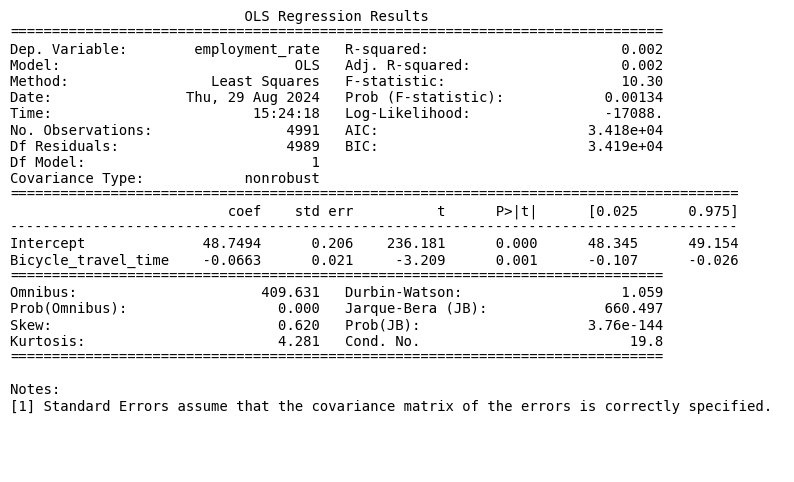

In [90]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from io import BytesIO

# Convert the regression results to a string
result_summary_B = model_employment_rate_B.summary().as_text()

# Create a Matplotlib figure
fig, ax = plt.subplots(figsize=(10, 6))  # You can adjust the size

# Hide the axes
ax.axis('off')

# Display the regression results text in the figure
ax.text(0, 1, result_summary_B, fontsize=10, ha='left', va='top', family='monospace')

# Save as a PNG file
plt.savefig('Plot/OLS_regression_employment_rate_B.png', bbox_inches='tight', dpi=300)

# Display the image
plt.show()


# 6. Distribution Plot

## 6.1 Load Geojson file

In [93]:
# Import Libs
import geopandas as gpd

# Reading geojson files 
London_LSOA_gdf = gpd.read_file("Dataset/London_LSOA_2021.geojson")

In [94]:
London_LSOA_gdf.crs

<Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.01, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

In [95]:
# Convert GeoDataFrame to DataFrame
London_LSOA_dropped = London_LSOA_gdf.to_crs(epsg='27700')

In [96]:
London_LSOA_dropped.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 4994 entries, 0 to 4993
Data columns (total 9 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   FID       4994 non-null   int64   
 1   LSOA21CD  4994 non-null   object  
 2   LSOA21NM  4994 non-null   object  
 3   BNG_E     4994 non-null   int64   
 4   BNG_N     4994 non-null   int64   
 5   LONG      4994 non-null   float64 
 6   LAT       4994 non-null   float64 
 7   GlobalID  4994 non-null   object  
 8   geometry  4994 non-null   geometry
dtypes: float64(2), geometry(1), int64(3), object(3)
memory usage: 351.3+ KB


In [97]:
Final_df.head(2)

,FID,LSOA21CD,LSOA21NM,geometry,from_id,to_id,Walk_travel_time,Transit_travel_time,Walk_and_Transit_travel_time,Car_travel_time,Bicycle_travel_time,Level_3,Level_4,employment_rate
0,1,E01000001,City of London 001A,"POLYGON ((532151.5375 181867.433499999, 532152...",1,183,10.0,10.0,10.0,4,8,6.356245,83.222469,57.916103
1,2,E01000002,City of London 001B,"POLYGON ((532634.497 181926.016000001, 532632....",2,183,7.0,7.0,7.0,2,5,6.846154,83.538462,62.906725


In [98]:
from shapely import wkt

Final_df['geometry'] = Final_df['geometry'].apply(wkt.loads)

In [99]:
# 将Final_df转换为GeoDataFrame
Final_df_gpd = gpd.GeoDataFrame(Final_df, geometry='geometry')

## 6.2 Level_4 Spatial Distribution

In [101]:
# import numpy as np
# import matplotlib.pyplot as plt
# from scipy.stats import norm, lognorm

# # Define 50 bins
# bins = 50

# # Create a histogram
# fig, ax = plt.subplots(figsize=(12, 8), dpi=150)
# count_per_bin, bin_edges, _ = ax.hist(Final_df_gpd['Level_4'], bins=bins, color='lightblue', edgecolor='black', alpha=0.7)

# # Fit a normal distribution
# mu, std = norm.fit(Final_df_gpd['Level_4'])

# # Fit a log-normal distribution
# shape, loc, scale = lognorm.fit(Final_df_gpd['Level_4'], floc=0)

# # Generate data for the normal distribution curve
# xmin, xmax = ax.get_xlim()
# x = np.linspace(xmin, xmax, 100)
# p_norm = norm.pdf(x, mu, std)
# p_lognorm = lognorm.pdf(x, shape, loc, scale)

# # Scale the y-axis of the curves to match the histogram
# p_norm = p_norm * (count_per_bin.max() / p_norm.max())
# p_lognorm = p_lognorm * (count_per_bin.max() / p_lognorm.max())

# # Plot the normal distribution curve
# ax.plot(x, p_norm, color='darkred', linestyle='-', linewidth=1, label='Normal fit')
# ax.plot(x, p_lognorm, color='darkgreen', linestyle='-', linewidth=1, label='Log-Normal fit')

# # Add grid lines
# ax.grid(True, linestyle='--', alpha=0.7)

# # Add labels and title
# ax.set_xlabel('Level_4 Ranges', fontsize=14)
# ax.set_ylabel('Count', fontsize=14)
# ax.set_title('Distribution of Level_4 with Normal and Log-Normal Distribution Fits', fontsize=16, weight='bold')

# # Set x and y axis tick label font size
# ax.tick_params(axis='x', labelsize=12)
# ax.tick_params(axis='y', labelsize=12)

# # Display legend
# ax.legend()

# # Display the chart
# plt.show()


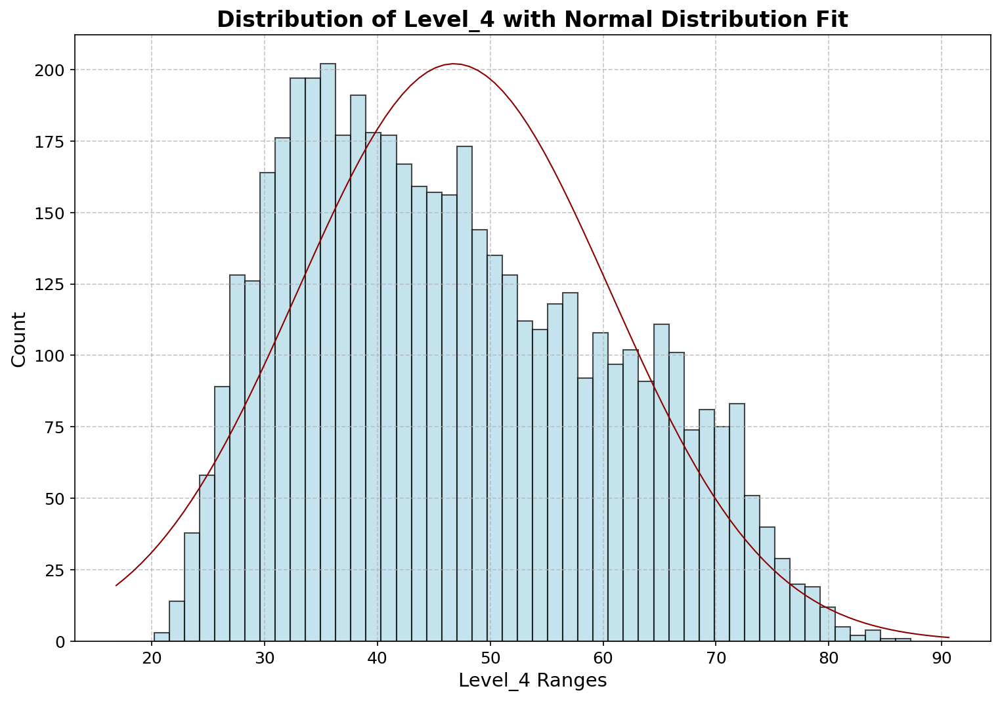

In [102]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm

# Define 50 bins
bins = 50

# Create a histogram
fig, ax = plt.subplots(figsize=(12, 8), dpi=150)  # Increase resolution and size
count_per_bin, bin_edges, _ = ax.hist(Final_df_gpd['Level_4'], bins=bins, color='lightblue', edgecolor='black', alpha=0.7)

# Fit a normal distribution
mu, std = norm.fit(Final_df_gpd['Level_4'])

# Generate data for the normal distribution curve
xmin, xmax = ax.get_xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)

# Scale the y-axis of the curve to match the histogram
p = p * (count_per_bin.max() / p.max())

# Plot the normal distribution curve
ax.plot(x, p, color='darkred', linestyle='-', linewidth=1, label='Normal fit')  # Increase line width

# Add grid lines
ax.grid(True, linestyle='--', alpha=0.7)

# Add labels and title
ax.set_xlabel('Level_4 Ranges', fontsize=14)
ax.set_ylabel('Count', fontsize=14)
ax.set_title('Distribution of Level_4 with Normal Distribution Fit', fontsize=16, weight='bold')

# Set x and y axis tick label font size
ax.tick_params(axis='x', labelsize=12)
ax.tick_params(axis='y', labelsize=12)

plt.savefig('Plot_final_0826/Distribution of Level_4 with Normal Distribution Fit.png', format='png', dpi=150)

# Display the chart
plt.show()


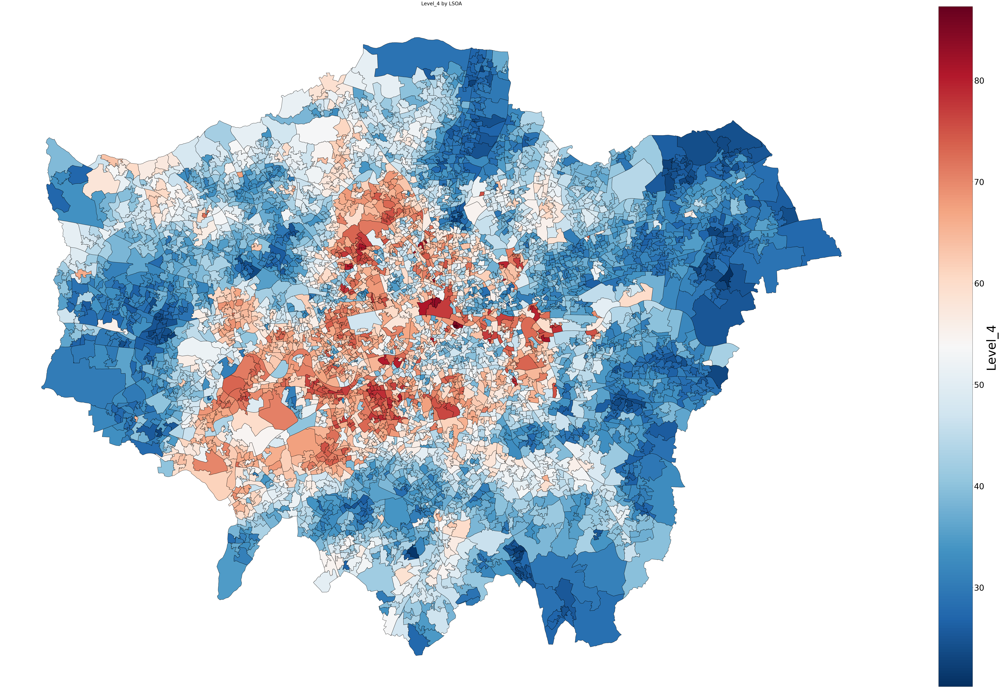

In [103]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Convert Final_df to a GeoDataFrame
Final_df_gpd = gpd.GeoDataFrame(Final_df, geometry='geometry')

# Set the minimum and maximum values for the color mapping
vmin = Final_df_gpd['Level_4'].min()
vmax = Final_df_gpd['Level_4'].max()

# Plot the map and color it based on the values in the Level_4 column
fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # Adjust the size to a more screen-friendly ratio
cmap = 'RdBu_r'
# cmap = 'coolwarm'
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# Use the GeoDataFrame's plot function to draw the map
Final_df_gpd.plot(column='Level_4', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# Hide the axis
ax.axis('off')

# Manually create a colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Level_4', fontsize=60)  # Set the font size for the colorbar label
cbar.ax.tick_params(labelsize=40)  # Set the font size for the colorbar ticks

plt.title('Level_4 by LSOA', fontsize=24)
plt.show()

## 6.3 Employment Rate Spatial Distribution

In [105]:
vmin = Final_df_gpd['employment_rate'].min() 
vmin

21.624629080118694

In [106]:
vmax = Final_df_gpd['employment_rate'].max() 
vmax 

84.44244604316546

In [107]:
# import numpy as np
# import matplotlib.pyplot as plt
# from scipy.stats import norm, lognorm

# # Define 50 bins
# bins = 50

# # Create a histogram
# fig, ax = plt.subplots(figsize=(12, 8), dpi=150)  # Increase resolution and size
# count_per_bin, bin_edges, _ = ax.hist(Final_df_gpd['employment_rate'], bins=bins, color='lightblue', edgecolor='black', alpha=0.7)

# # Fit a normal distribution
# mu, std = norm.fit(Final_df_gpd['employment_rate'])

# # Fit a log-normal distribution
# shape, loc, scale = lognorm.fit(Final_df_gpd['employment_rate'], floc=0)

# # Generate data for the normal distribution curve
# xmin, xmax = ax.get_xlim()
# x = np.linspace(xmin, xmax, 100)
# p_norm = norm.pdf(x, mu, std)
# p_lognorm = lognorm.pdf(x, shape, loc, scale)

# # Scale the y-axis of the curves to match the histogram
# p_norm = p_norm * (count_per_bin.max() / p_norm.max())
# p_lognorm = p_lognorm * (count_per_bin.max() / p_lognorm.max())

# # Plot the normal distribution curve
# ax.plot(x, p_norm, color='darkred', linestyle='-', linewidth=1, label='Normal fit')
# ax.plot(x, p_lognorm, color='darkgreen', linestyle='-', linewidth=1, label='Log-Normal fit')

# # Add grid lines
# ax.grid(True, linestyle='--', alpha=0.7)

# # Add labels and title
# ax.set_xlabel('Employment Rate Ranges', fontsize=14)
# ax.set_ylabel('Count', fontsize=14)
# ax.set_title('Distribution of Employment Rate with Normal and Log-Normal Distribution Fits', fontsize=16, weight='bold')

# # Set x and y axis tick label font size
# ax.tick_params(axis='x', labelsize=12)
# ax.tick_params(axis='y', labelsize=12)

# # Display legend
# ax.legend()

# # Display the chart
# plt.show()

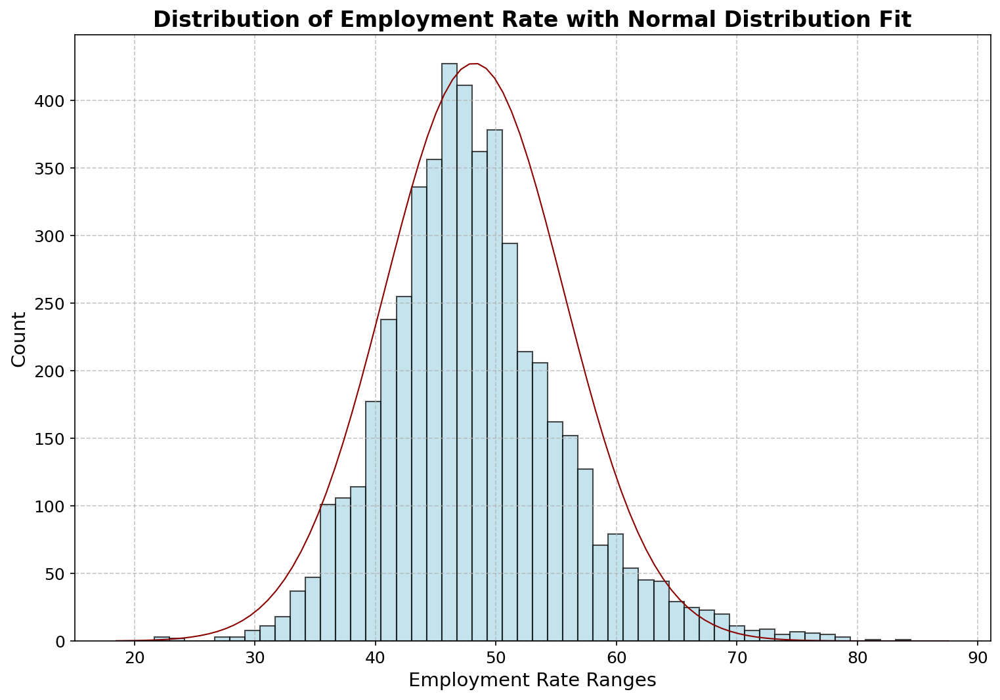

In [108]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm

# Define 50 bins
bins = 50

# Create a histogram
fig, ax = plt.subplots(figsize=(12, 8), dpi=150)  # Increase resolution and size
count_per_bin, bin_edges, _ = ax.hist(Final_df_gpd['employment_rate'], bins=bins, color='lightblue', edgecolor='black', alpha=0.7)

# Fit a normal distribution
mu, std = norm.fit(Final_df_gpd['employment_rate'])

# Generate data for the normal distribution curve
xmin, xmax = ax.get_xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)

# Scale the y-axis of the curve to match the histogram
p = p * (count_per_bin.max() / p.max())

# Plot the normal distribution curve
ax.plot(x, p, color='darkred', linestyle='-', linewidth=1, label='Normal fit')  # Increase line width

# Add grid lines
ax.grid(True, linestyle='--', alpha=0.7)

# Add labels and title
ax.set_xlabel('Employment Rate Ranges', fontsize=14)
ax.set_ylabel('Count', fontsize=14)
ax.set_title('Distribution of Employment Rate with Normal Distribution Fit', fontsize=16, weight='bold')

# Set x and y axis tick label font size
ax.tick_params(axis='x', labelsize=12)
ax.tick_params(axis='y', labelsize=12)

plt.savefig('Plot_final_0826/Distribution of Employment Rate with Normal Distribution Fit.png', format='png', dpi=150)

# Display the chart
plt.show()

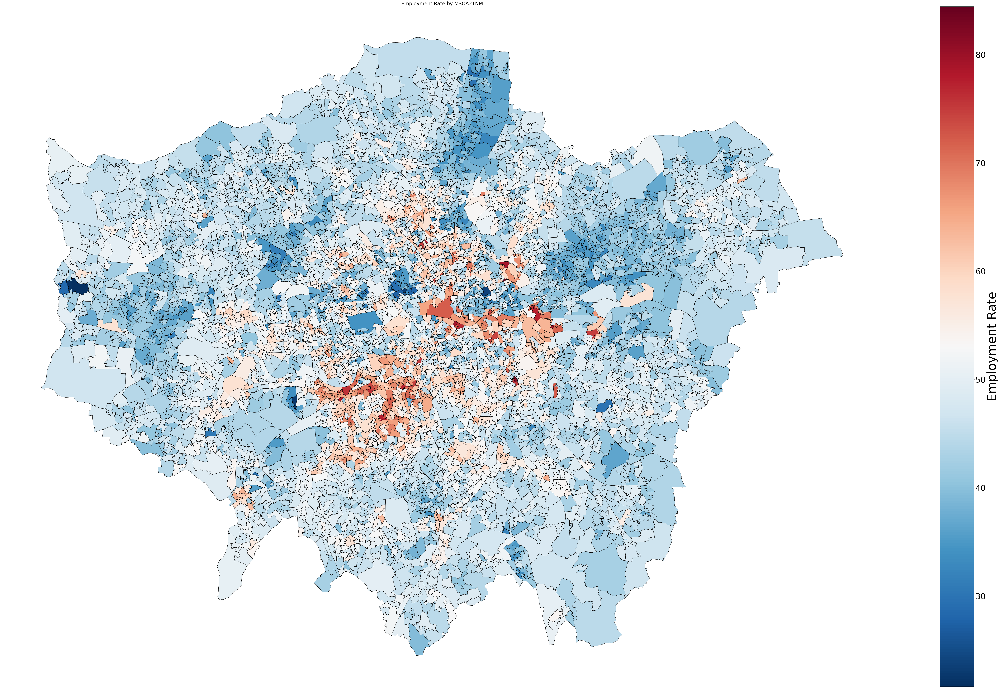

In [109]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Convert Final_df to a GeoDataFrame
Final_df_gpd = gpd.GeoDataFrame(Final_df, geometry='geometry')

# Set the minimum and maximum values for the color mapping
vmin = Final_df_gpd['employment_rate'].min()
vmax = Final_df_gpd['employment_rate'].max()

# Plot the map and color it based on the values in the employment_rate column
fig, ax = plt.subplots(1, 1, figsize=(100, 60))  # Adjust the size to a more screen-friendly ratio
cmap = 'RdBu_r'
# cmap = 'coolwarm'
norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

# Use the GeoDataFrame's plot function to draw the map
Final_df_gpd.plot(column='employment_rate', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# Hide the axis
ax.axis('off')

# Manually create a colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Employment Rate', fontsize=60)  # Set the font size for the colorbar label
cbar.ax.tick_params(labelsize=40)  # Set the font size for the colorbar ticks

plt.title('Employment Rate by MSOA21NM', fontsize=24)
plt.show()

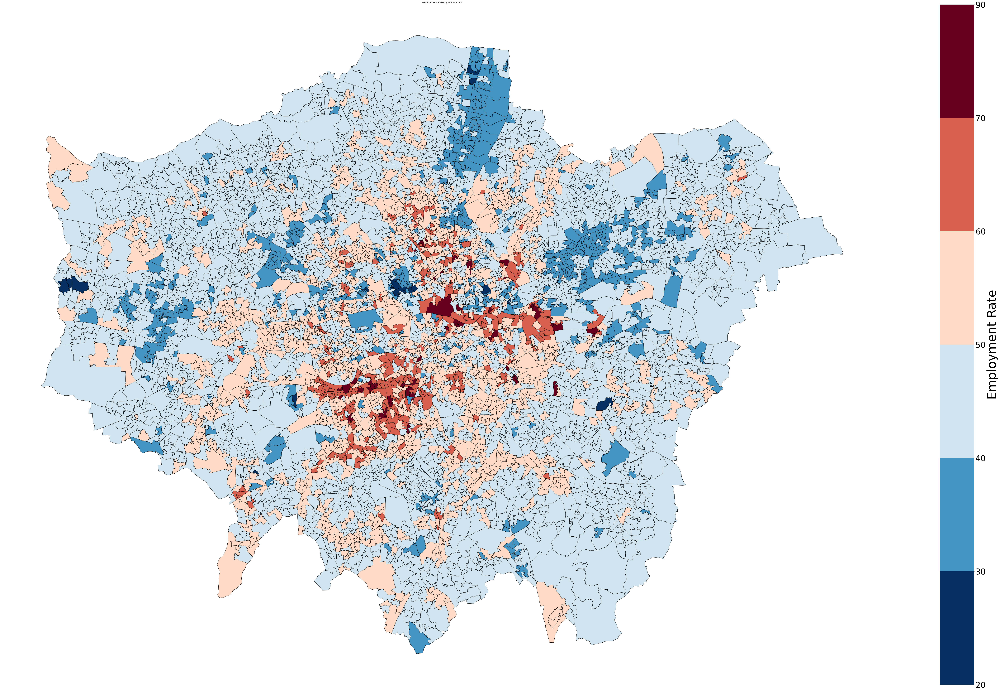

In [110]:
import geopandas as gpd
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Convert Final_df to a GeoDataFrame
Final_df_gpd = gpd.GeoDataFrame(Final_df, geometry='geometry')

# Define intervals
bounds = [20, 30, 40, 50, 60, 70, 90]
cmap = plt.get_cmap('RdBu_r')

# Use BoundaryNorm to create intervals for the colorbar
norm = mcolors.BoundaryNorm(bounds, cmap.N)

# Plot the map and color it based on the values in the employment_rate column
fig, ax = plt.subplots(1, 1, figsize=(100, 60))
Final_df_gpd.plot(column='employment_rate', cmap=cmap, legend=False, norm=norm, ax=ax, edgecolor='black')

# Hide the axis
ax.axis('off')

# Manually add the colorbar and set its boundaries
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Employment Rate', fontsize=60)  # Set the font size for the colorbar label
cbar.ax.tick_params(labelsize=40)  # Set the font size for the colorbar ticks

plt.title('Employment Rate by MSOA21NM')
plt.show()